# Final Project DLS 1sem
**Made by Khodosevich Leonid**


# Imports

In [1]:
!pip install torchsummary

In [2]:
# library imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import PIL

from torchvision import transforms
from torchvision.datasets import ImageFolder, DatasetFolder

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as opt
import torch.utils.data as data_utils

from torchsummary import summary

from tqdm.notebook import tqdm
from argparse import Namespace
import json

torch.manual_seed(42)

In [3]:
args = Namespace(
    device="cuda" if torch.cuda.is_available() else "cpu",
    batch_size=2,
)

In [4]:
# images import
i_f = ImageFolder(r"/kaggle/input/monet2photo")

In [5]:
# print number of images
monet_train_num = (torch.Tensor(i_f.targets) == 2).sum()
monet_test_num = (torch.Tensor(i_f.targets) == 0).sum()
real_train_num = (torch.Tensor(i_f.targets) == 3).sum()
real_test_num = (torch.Tensor(i_f.targets) == 1).sum()
print(f"Number of Monet's paintings train: {monet_train_num}")
print(f"Number of Monet's paintings test: {monet_test_num}")
print(f"Number of real life train: {real_train_num}")
print(f"Number of real life test: {real_test_num}")

Number of Monet's paintings train: 1072
Number of Monet's paintings test: 121
Number of real life train: 6287
Number of real life test: 751


In [6]:
def load_images(folder, start, end):
    """
    Loads images from ImageFolder from start to end, turning them into torch Dataset  
    """
    images = torch.Tensor()
    for image, _ in tqdm(folder.imgs[start:end]):
        im = transforms.ToTensor()(PIL.Image.open(image)).unsqueeze(0)
        images = torch.concat([images, im], dim=0)
    return images

In [7]:
#monet_test = load_images(i_f, 0, monet_test_num) # load monet test from 0 to 120
#real_test = load_images(i_f, monet_test_num, monet_test_num + real_test_num) # load real test from 121 to 
monet_train = load_images(i_f, monet_test_num + real_test_num, monet_test_num + real_test_num + 500)
real_train = load_images(i_f,  monet_test_num + real_test_num + monet_train_num,  monet_test_num + real_test_num + monet_train_num + 500)

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

In [8]:
monet_train.shape

torch.Size([500, 3, 256, 256])

In [9]:
monet_train = monet_train[torch.randperm(monet_train.shape[0])]
real_train = real_train[torch.randperm(real_train.shape[0])]

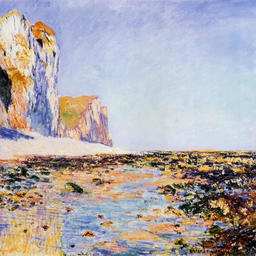

In [10]:
transforms.ToPILImage()(monet_train[0])

* TODO: SHUFFLING
* МБ Сконкатенировать трейн и тест

In [11]:
# Datasets
train_dataset = data_utils.TensorDataset(monet_train[0:1000], real_train)

In [12]:
# Dataloaders
train_dataloader = data_utils.DataLoader(train_dataset, shuffle=True, batch_size=args.batch_size, num_workers=2)

# Модели

Generator architectures We adopt our architectures
from Johnson et al. [23]. We use 6 residual blocks for
128  128 training images, and 9 residual blocks for 256 
256 or higher-resolution training images. Below, we follow
the naming convention used in the Johnson et al.’s Github
repository.
Let c7s1-k denote a 7x7 Convolution-InstanceNorm-
ReLU layer with k filters and stride 1. dk denotes a 3  3
Convolution-InstanceNorm-ReLU layer with k filters and
stride 2. Reflection padding was used to reduce artifacts.
Rk denotes a residual block that contains two 3  3 convolutional
layers with the same number of filters on both
layer. uk denotes a 3  3 fractional-strided-Convolution-
InstanceNorm-ReLU layer with k filters and stride 1
2 .
The network with 6 residual blocks consists of:
c7s1-64,d128,d256,R256,R256,R256,
R256,R256,R256,u128,u64,c7s1-3
The network with 9 residual blocks consists of:
c7s1-64,d128,d256,R256,R256,R256,
R256,R256,R256,R256,R256,R256,u128
u64,c7s1-3

Архитектура блока ResNet  
Взята с сайта https://d2l.ai/chapter_convolutional-modern/resnet.html  
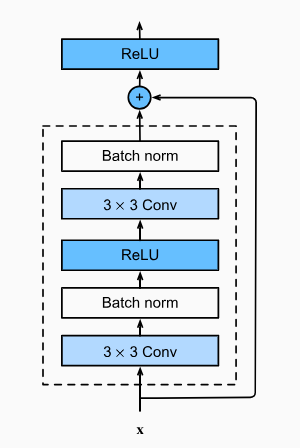

In [13]:
x = torch.randn(8, 256, 63, 63)
x = nn.Sequential(
    nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
    nn.InstanceNorm2d(256),
    nn.ReLU(True),
    nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
    nn.InstanceNorm2d(256),
)(x)
print(x.shape)

torch.Size([8, 256, 63, 63])


In [14]:
class ResBlock256(nn.Module):
    def __init__(self):
        super(ResBlock256, self).__init__()
        
        self.proc = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.InstanceNorm2d(256),
            nn.ReLU(True),
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.InstanceNorm2d(256),
        )
        self._init_weights()
        
    def _init_weights(module):
        if isinstance(module, nn.Conv2d) or isinstance(module, nn.ConvTranspose2d):
            module.weight.data.normal_(mean=0.0, std=0.02)
            module.bias.data.fill_(0)
    
    def forward(self, x_in):
        x = self.proc(x_in)
        return x + x_in

In [15]:
x = torch.randn(8, 3, 256, 256)
x = nn.Sequential(
    nn.ReflectionPad2d((3, 3, 3, 3)),
    nn.Conv2d(in_channels=3, out_channels=64, kernel_size=7, stride=1),
    nn.InstanceNorm2d(64),
    nn.ReLU(True),
    nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, stride=2, padding=1),
    nn.InstanceNorm2d(128),
    nn.ReLU(True),
    nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, stride=2, padding=1),
    nn.InstanceNorm2d(128),
    nn.ReLU(True),
    
    ResBlock256(),
    nn.ReLU(True),
    ResBlock256(),
    nn.ReLU(True),
    ResBlock256(),
    nn.ReLU(True),
    ResBlock256(),
    nn.ReLU(True),
    ResBlock256(),
    nn.ReLU(True),
    ResBlock256(),
    nn.ReLU(True),
    
    nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=1, output_padding=1),
    nn.InstanceNorm2d(128),
    nn.ReLU(True),
    
    nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, stride=2, padding=1, output_padding=1),
    nn.InstanceNorm2d(128),
    nn.ReLU(True),
    
    nn.ReflectionPad2d((3, 3, 3, 3)),
    nn.Conv2d(in_channels=64, out_channels=3, kernel_size=7, stride=1),
    nn.Tanh()
)(x)
print(x.shape)

torch.Size([8, 3, 256, 256])


In [16]:
class CycleGANGenerator(nn.Module):
    def __init__(self):
        super(CycleGANGenerator, self).__init__()
        self.net = nn.Sequential(
            nn.ReflectionPad2d((3, 3, 3, 3)),
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=7, stride=1),
            nn.InstanceNorm2d(64),
            nn.ReLU(True),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, stride=2, padding=1),
            nn.InstanceNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, stride=2, padding=1),
            nn.InstanceNorm2d(128),
            nn.ReLU(True),

            ResBlock256(),
            nn.ReLU(True),
            ResBlock256(),
            nn.ReLU(True),
            ResBlock256(),
            nn.ReLU(True),
            ResBlock256(),
            nn.ReLU(True),
            ResBlock256(),
            nn.ReLU(True),
            ResBlock256(),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.InstanceNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.InstanceNorm2d(128),
            nn.ReLU(True),

            nn.ReflectionPad2d((3, 3, 3, 3)),
            nn.Conv2d(in_channels=64, out_channels=3, kernel_size=7, stride=1),
            nn.Tanh()
        )
        self._init_weights()
        
    def _init_weights(module):
        if isinstance(module, nn.Conv2d) or isinstance(module, nn.ConvTranspose2d):
            module.weight.data.normal_(mean=0.0, std=0.02)
            module.bias.data.fill_(0)
        
    def forward(self, x_in):
        return self.net(x_in)

Discriminator architectures For discriminator networks,
we use 70 x 70 PatchGAN [22]. Let Ck denote a
4 x 4 Convolution-InstanceNorm-LeakyReLU layer with k
filters and stride 2. After the last layer, we apply a convolution
to produce a 1-dimensional output. We do not use
InstanceNorm for the first C64 layer. We use leaky ReLUs
with a slope of 0:2. The discriminator architecture is:
C64-C128-C256-C512

In [17]:
x = torch.randn(8, 3, 256, 256)
x = nn.Sequential(
    nn.Conv2d(in_channels=3, out_channels=64, kernel_size=4, stride=2, padding=1),
    nn.LeakyReLU(0.2, True),
    nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1),
    nn.InstanceNorm2d(128),
    nn.LeakyReLU(0.2, True),
    nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1),
    nn.InstanceNorm2d(256),
    nn.LeakyReLU(0.2, True),
    nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1),
    nn.InstanceNorm2d(512),
    nn.LeakyReLU(0.2, True),
    nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=1),
)(x)
print(x.shape)

torch.Size([8, 1, 15, 15])


In [18]:
class CycleGANDiscriminator(nn.Module):
    def __init__(self):
        super(CycleGANDiscriminator, self).__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1),
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1),
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1),
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=1),
        )
        self._init_weights()
        
    def _init_weights(module):
        if isinstance(module, nn.Conv2d) or isinstance(module, nn.ConvTranspose2d):
            module.weight.data.normal_(mean=0.0, std=0.02)
            module.bias.data.fill_(0)
        
    def forward(self, x_in):
        return self.net(x_in)

In [19]:
summary(CycleGANGenerator().to(args.device), (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ReflectionPad2d-1          [-1, 3, 262, 262]               0
            Conv2d-2         [-1, 64, 256, 256]           9,472
    InstanceNorm2d-3         [-1, 64, 256, 256]               0
              ReLU-4         [-1, 64, 256, 256]               0
            Conv2d-5        [-1, 128, 128, 128]          73,856
    InstanceNorm2d-6        [-1, 128, 128, 128]               0
              ReLU-7        [-1, 128, 128, 128]               0
            Conv2d-8          [-1, 256, 64, 64]         295,168
    InstanceNorm2d-9          [-1, 256, 64, 64]               0
             ReLU-10          [-1, 256, 64, 64]               0
           Conv2d-11          [-1, 256, 64, 64]         590,080
   InstanceNorm2d-12          [-1, 256, 64, 64]               0
             ReLU-13          [-1, 256, 64, 64]               0
           Conv2d-14          [-1, 256,

In [20]:
summary(CycleGANDiscriminator().to(args.device), (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           3,136
         LeakyReLU-2         [-1, 64, 128, 128]               0
            Conv2d-3          [-1, 128, 64, 64]         131,200
    InstanceNorm2d-4          [-1, 128, 64, 64]               0
         LeakyReLU-5          [-1, 128, 64, 64]               0
            Conv2d-6          [-1, 256, 32, 32]         524,544
    InstanceNorm2d-7          [-1, 256, 32, 32]               0
         LeakyReLU-8          [-1, 256, 32, 32]               0
            Conv2d-9          [-1, 512, 16, 16]       2,097,664
   InstanceNorm2d-10          [-1, 512, 16, 16]               0
        LeakyReLU-11          [-1, 512, 16, 16]               0
           Conv2d-12            [-1, 1, 15, 15]           8,193
Total params: 2,764,737
Trainable params: 2,764,737
Non-trainable params: 0
---------------------------

In [21]:
G_model_A_B = CycleGANGenerator().to(args.device)
F_model_B_A = CycleGANGenerator().to(args.device)

D_A = CycleGANDiscriminator().to(args.device)
D_B = CycleGANDiscriminator().to(args.device)

In [22]:
transforms_ = [
    transforms.RandomHorizontalFlip(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
]
# helpful functions
def display_in_out_rec(A_B_model, B_A_model, image, mode):
    """
    Displaying images like in article
    """
    fig, ax = plt.subplots(1, 3, figsize=(15,8))
    if mode == 'A2B':
        ax[0].set_title("Input $x$")
        ax[1].set_title("Output $G(x)$")
        ax[2].set_title("Reconstruction $F(G(x))$")
        out = A_B_model(image).detach().cpu()
        rec = B_A_model(out.to(args.device)).detach().cpu()
    else:
        ax[0].set_title("Input $y$")
        ax[1].set_title("Output $F(y)$")
        ax[2].set_title("Reconstruction $G(F(y))$")
        out = B_A_model(image).detach().cpu()
        rec = A_B_model(out.to(args.device)).detach().cpu()

    ax[0].imshow(transforms.ToPILImage()(image*0.5 + 0.5))
    ax[0].axis('off')
    ax[1].imshow(transforms.ToPILImage()(out*0.5 + 0.5))
    ax[1].axis('off')
    ax[2].imshow(transforms.ToPILImage()(rec*0.5 + 0.5))
    ax[2].axis('off')
    
    plt.show()
    
def apply_transforms(image, transforms_):
    for trans in transforms_:
        image = trans(image)
    return image

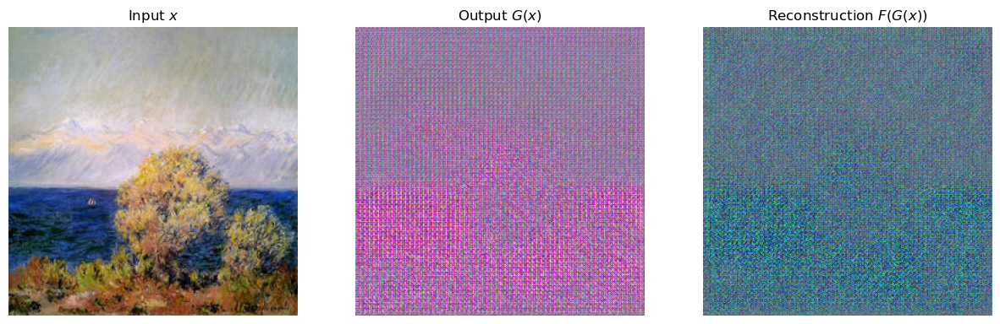

In [23]:
display_in_out_rec(G_model_A_B, F_model_B_A, apply_transforms(train_dataset[1][0], transforms_).to(args.device), "A2B")

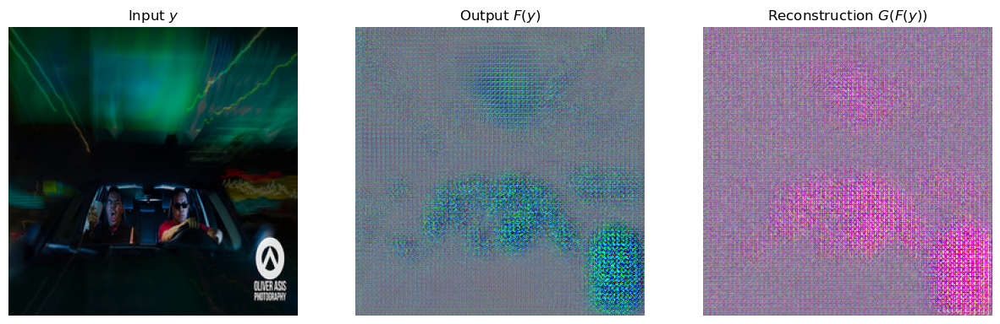

In [24]:
display_in_out_rec(G_model_A_B, F_model_B_A, apply_transforms(train_dataset[1][1], transforms_).to(args.device), "B2A")

# Loss
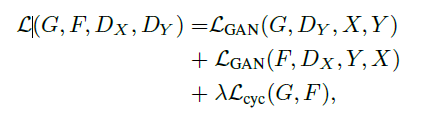  
, where  
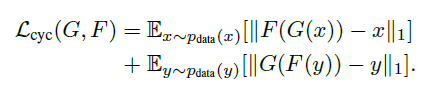  
$L_{GAN} = MSE$ described in 4 (Training Details) in article
  
Also I've added identity loss:  
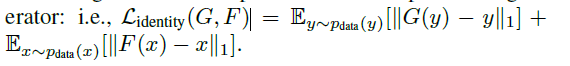

In [25]:
criterion_GAN = nn.MSELoss()
criterion_cycle = nn.L1Loss()
criterion_identity = nn.L1Loss()

In [26]:
# train_state_dict
train_state = Namespace(
    num_epochs = 100,
    
    lr = 0.0002,
    lr_start_factor = 1.0,
    lr_end_factor = 0.0,
    
    train_loss_gen = [],
    train_loss_cyc = [],
    train_loss_gan = [],
    train_loss_id = [],
    train_loss_disc_A = [],
    train_loss_disc_B = [],
    
    lmbd = 10,
)
train_state.lr_total_iters = int(train_state.num_epochs // 2)

In [27]:
train_state._get_kwargs()

[('num_epochs', 100),
 ('lr', 0.0002),
 ('lr_start_factor', 1.0),
 ('lr_end_factor', 0.0),
 ('train_loss_gen', []),
 ('train_loss_cyc', []),
 ('train_loss_gan', []),
 ('train_loss_id', []),
 ('train_loss_disc_A', []),
 ('train_loss_disc_B', []),
 ('lmbd', 10),
 ('lr_total_iters', 50)]

In [28]:
torch.cuda.empty_cache()

In [29]:
G_model_A_B = CycleGANGenerator().to(args.device)
F_model_B_A = CycleGANGenerator().to(args.device)

D_A = CycleGANDiscriminator().to(args.device)
D_B = CycleGANDiscriminator().to(args.device)

training:   0%|          | 0/100 [00:00<?, ?it/s]

split=train:   0%|          | 0/250 [00:00<?, ?it/s]



------------------------------------------------------------------------------------EPOCH #0-----------------------------------------------------------------------------------


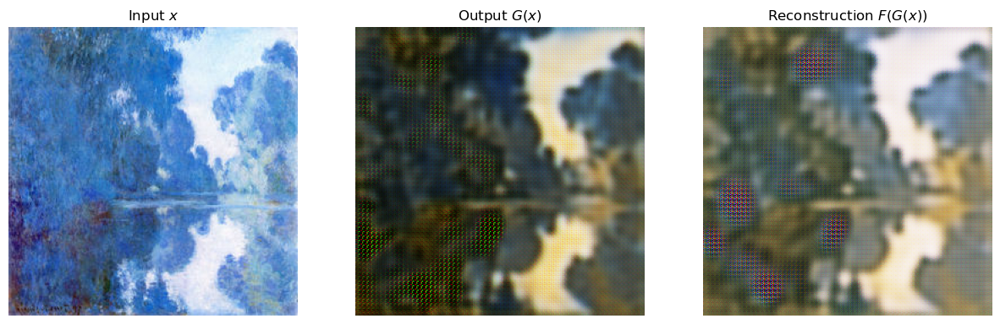

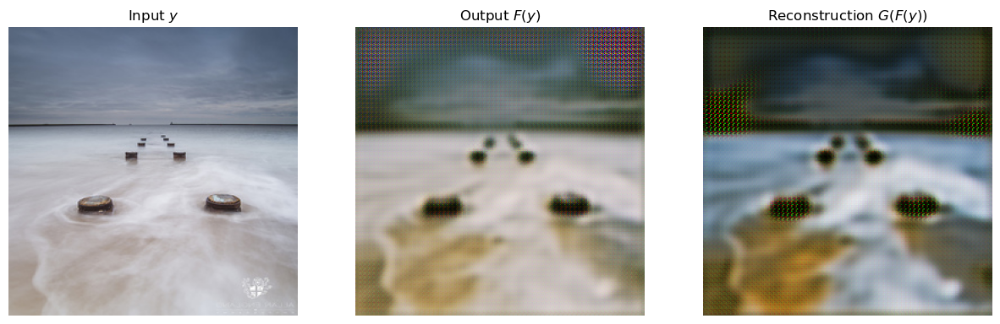



------------------------------------------------------------------------------------EPOCH #5-----------------------------------------------------------------------------------


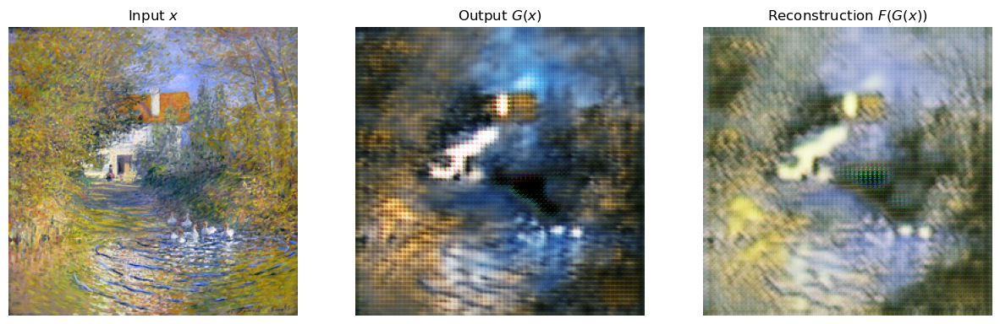

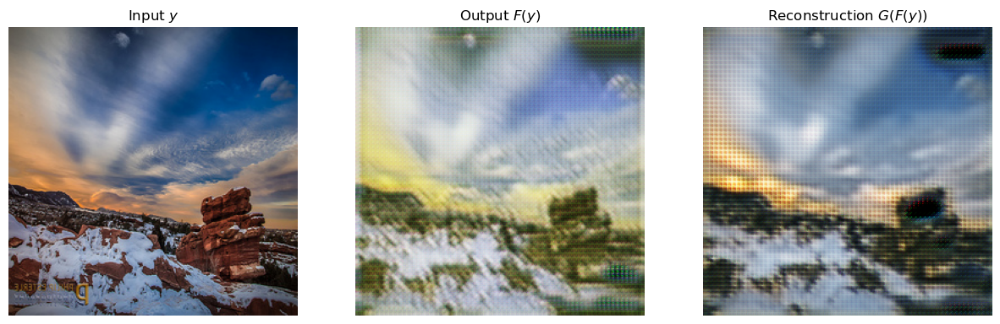



-----------------------------------------------------------------------------------EPOCH #10-----------------------------------------------------------------------------------


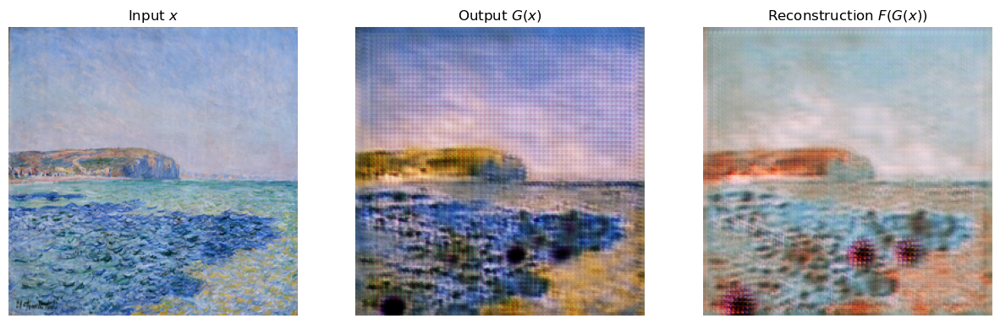

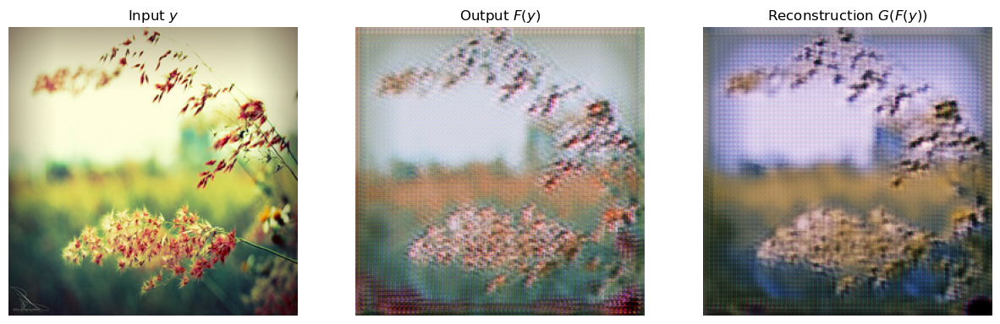



-----------------------------------------------------------------------------------EPOCH #15-----------------------------------------------------------------------------------


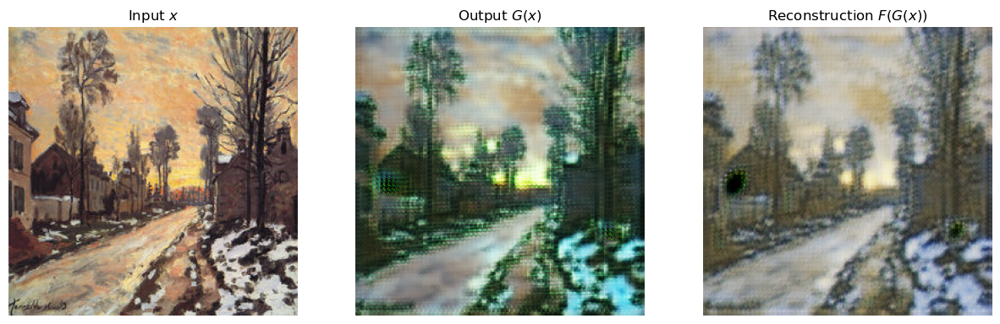

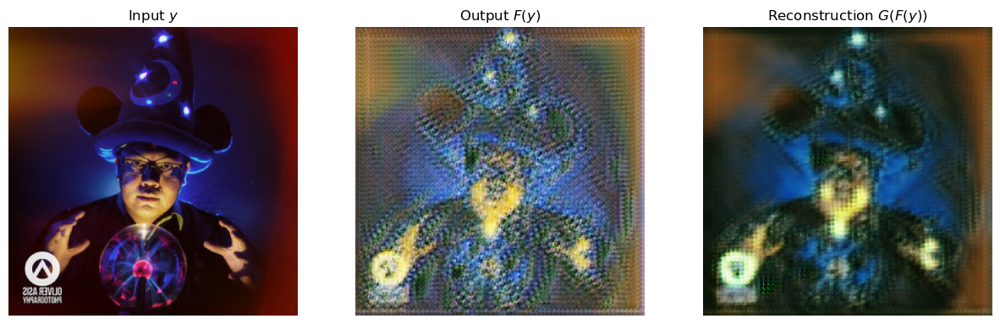



-----------------------------------------------------------------------------------EPOCH #20-----------------------------------------------------------------------------------


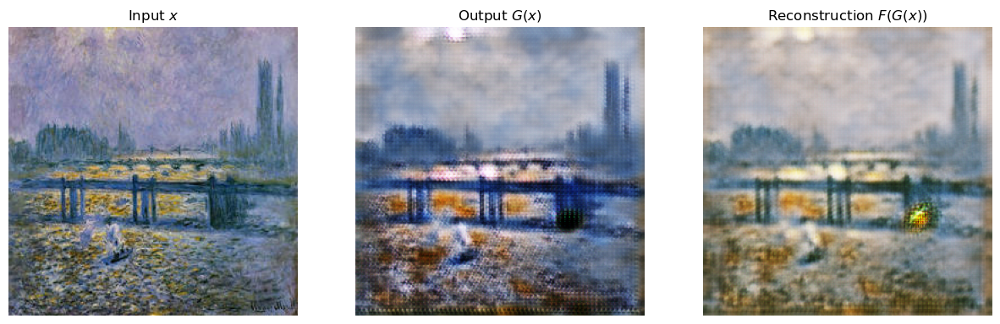

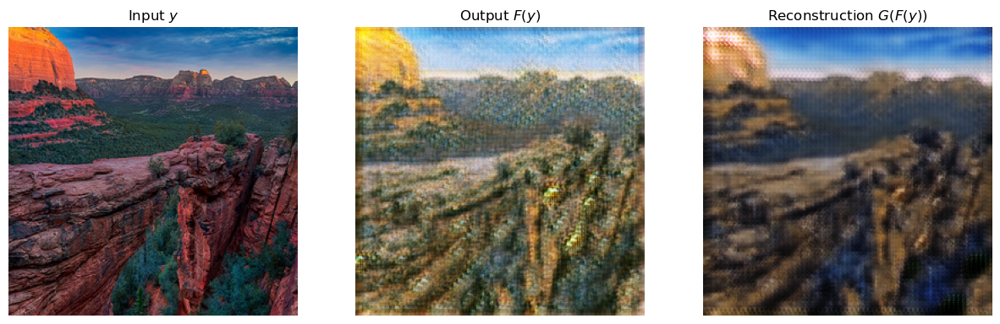



-----------------------------------------------------------------------------------EPOCH #25-----------------------------------------------------------------------------------


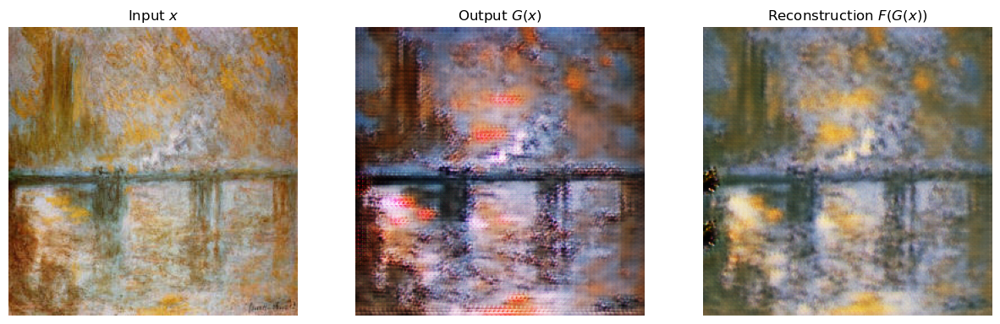

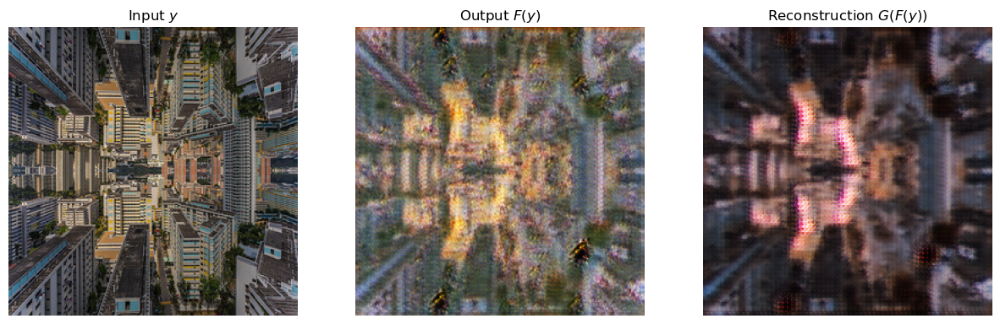



-----------------------------------------------------------------------------------EPOCH #30-----------------------------------------------------------------------------------


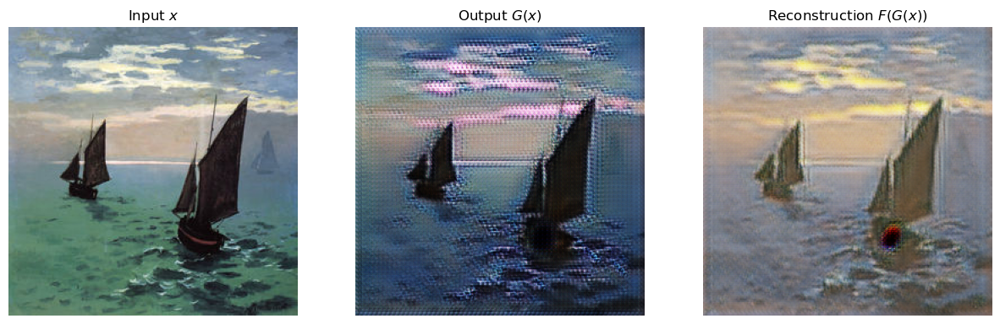

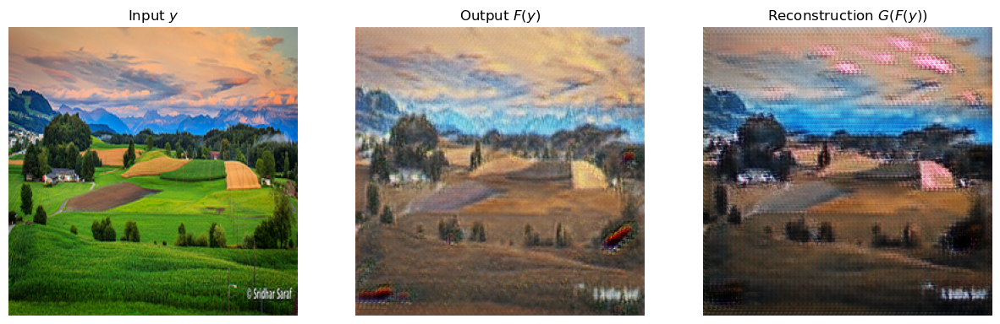



-----------------------------------------------------------------------------------EPOCH #35-----------------------------------------------------------------------------------


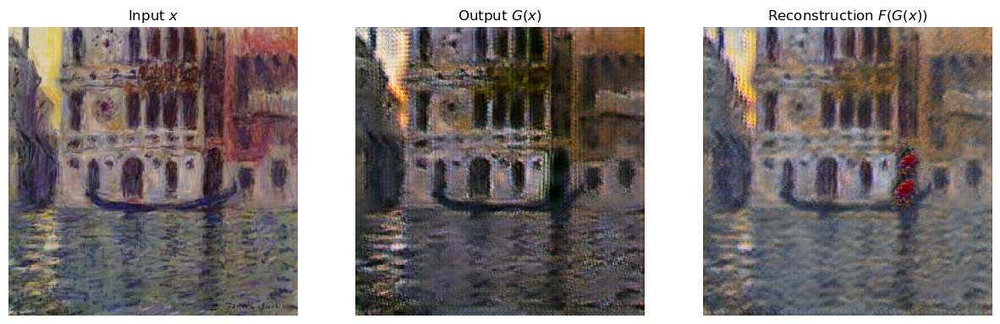

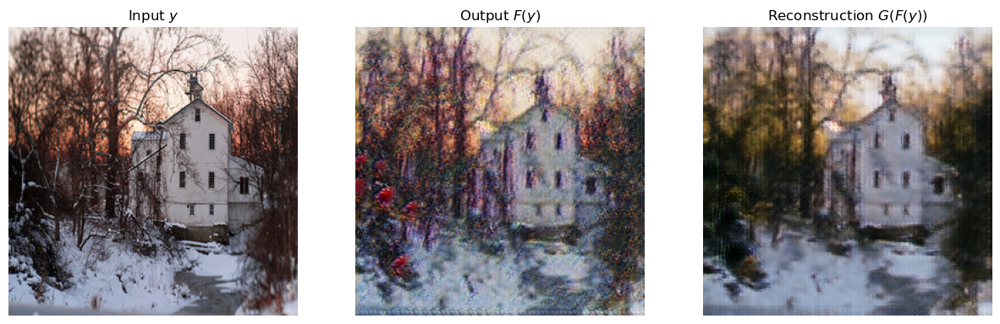



-----------------------------------------------------------------------------------EPOCH #40-----------------------------------------------------------------------------------


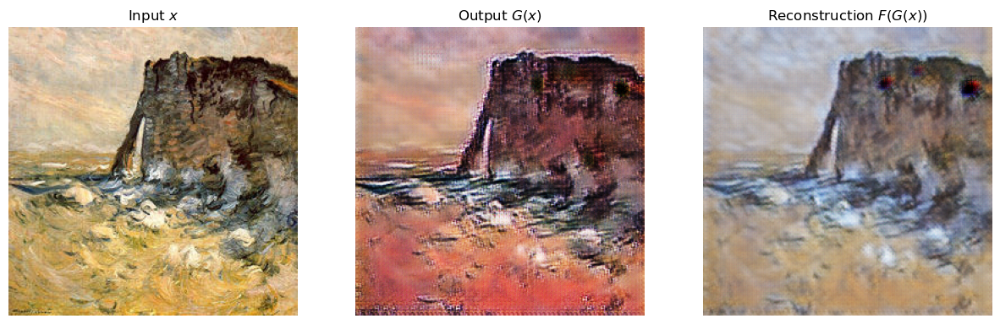

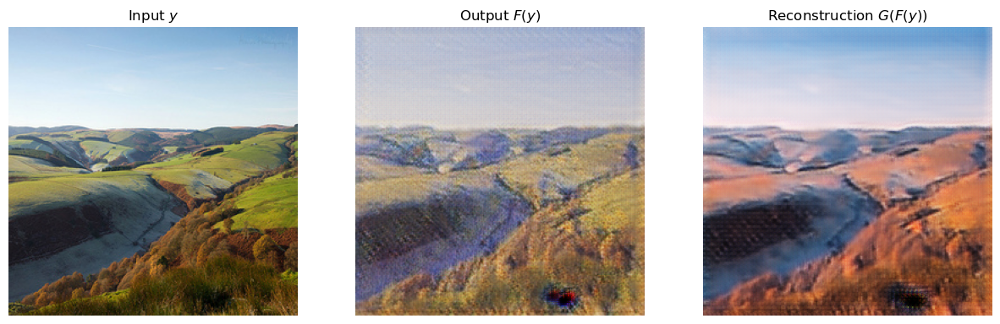



-----------------------------------------------------------------------------------EPOCH #45-----------------------------------------------------------------------------------


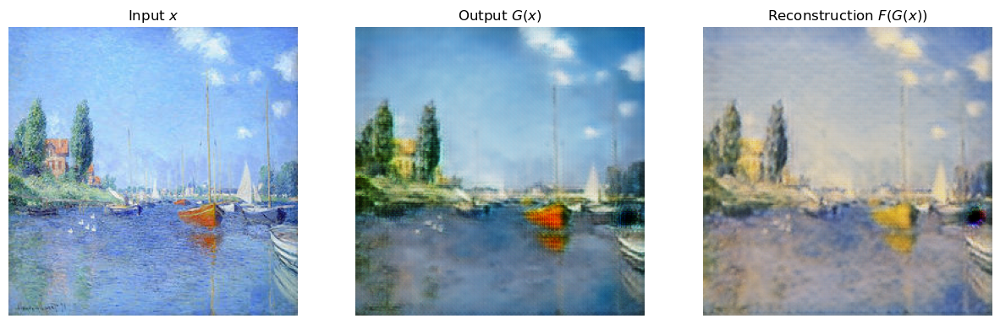

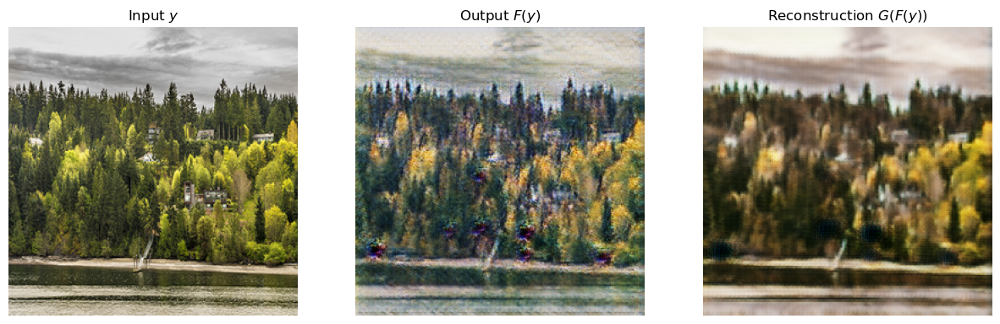

lr=[0.0002]


-----------------------------------------------------------------------------------EPOCH #50-----------------------------------------------------------------------------------


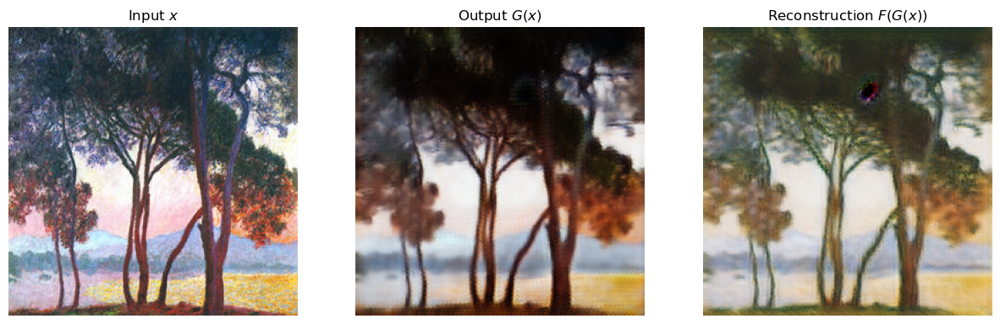

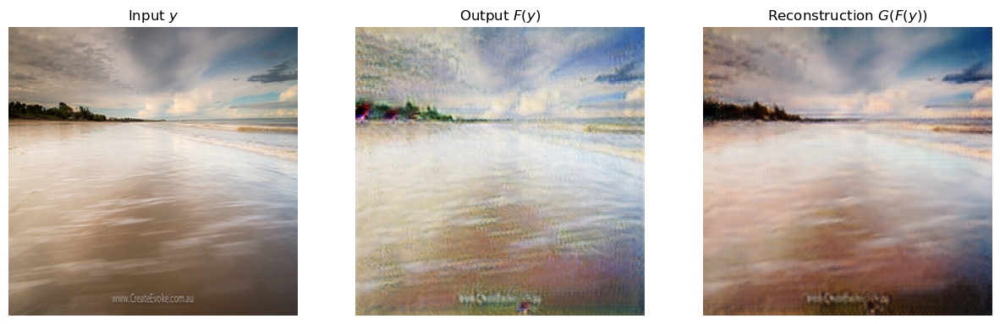

lr=[0.000196]
lr=[0.00019199999999999998]
lr=[0.00018799999999999996]
lr=[0.00018399999999999995]
lr=[0.00017999999999999996]


-----------------------------------------------------------------------------------EPOCH #55-----------------------------------------------------------------------------------


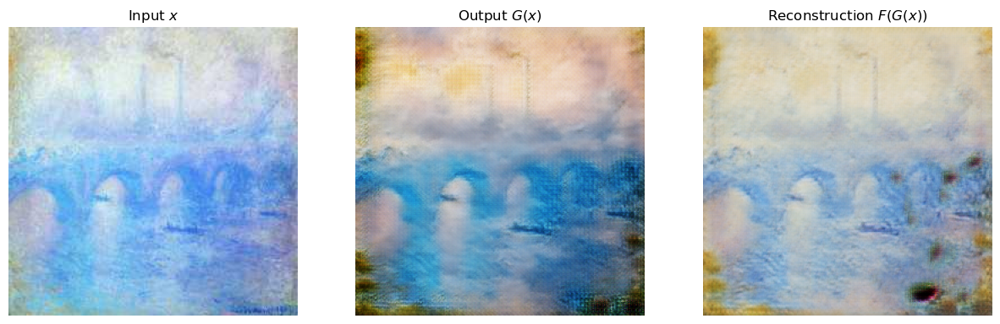

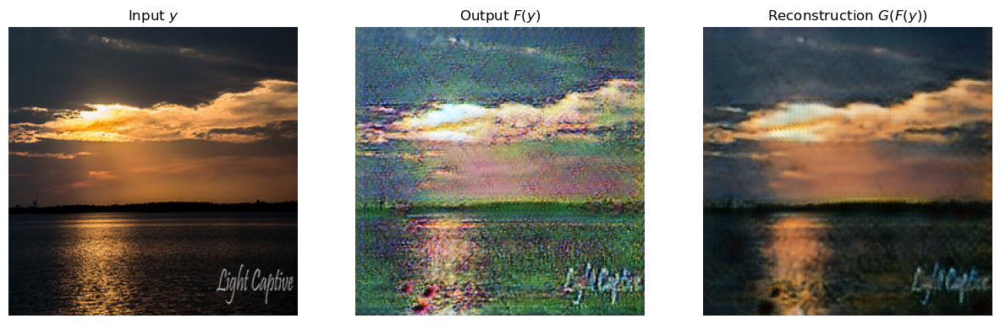

lr=[0.00017599999999999994]
lr=[0.00017199999999999995]
lr=[0.00016799999999999994]
lr=[0.00016399999999999992]
lr=[0.00015999999999999993]


-----------------------------------------------------------------------------------EPOCH #60-----------------------------------------------------------------------------------


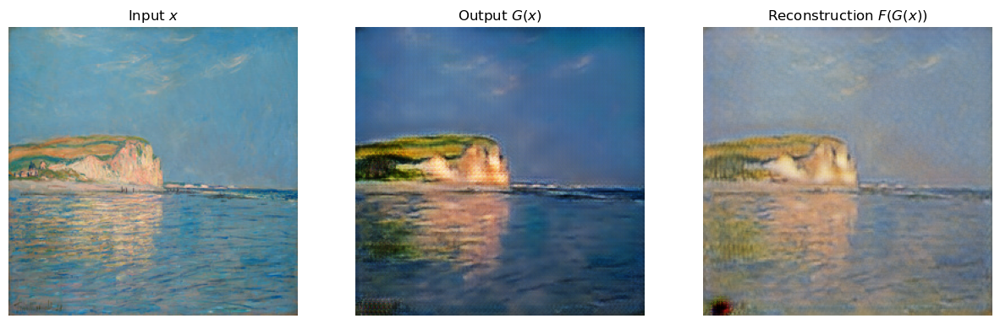

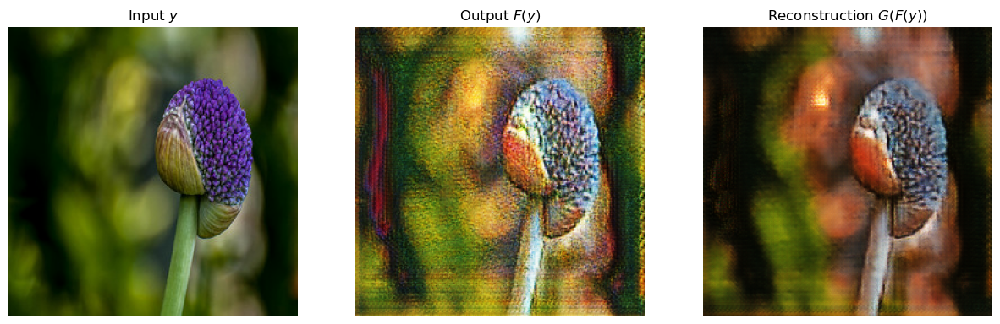

lr=[0.00015599999999999994]
lr=[0.00015199999999999995]
lr=[0.00014799999999999997]
lr=[0.00014399999999999998]
lr=[0.00014]


-----------------------------------------------------------------------------------EPOCH #65-----------------------------------------------------------------------------------


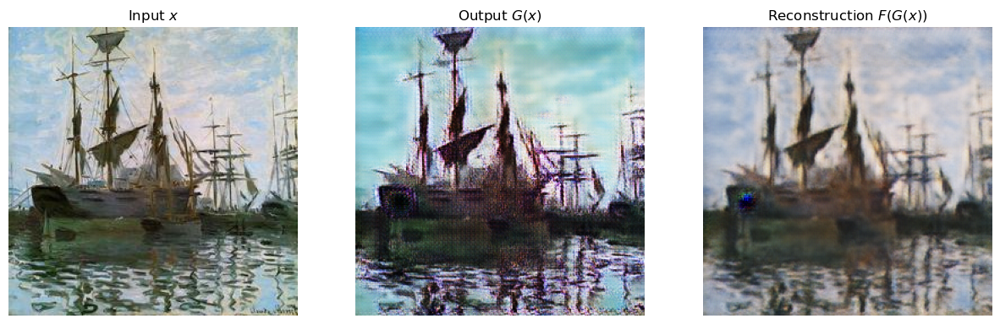

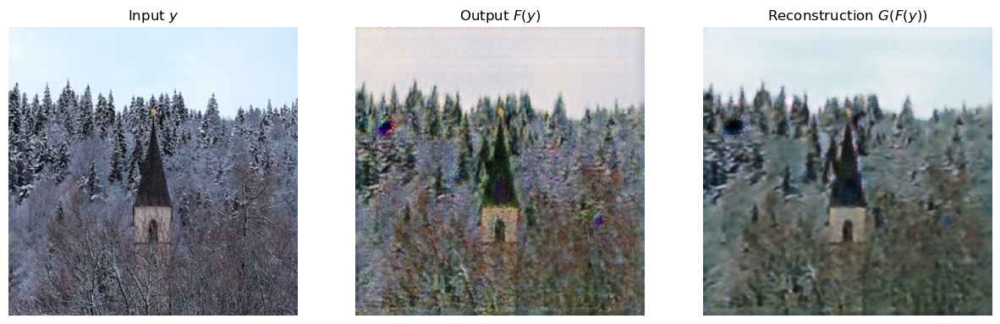

lr=[0.000136]
lr=[0.000132]
lr=[0.00012800000000000002]
lr=[0.00012400000000000003]
lr=[0.00012000000000000003]


-----------------------------------------------------------------------------------EPOCH #70-----------------------------------------------------------------------------------


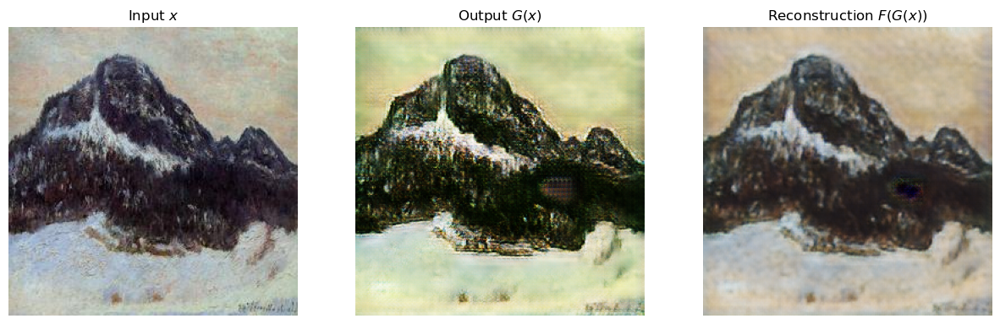

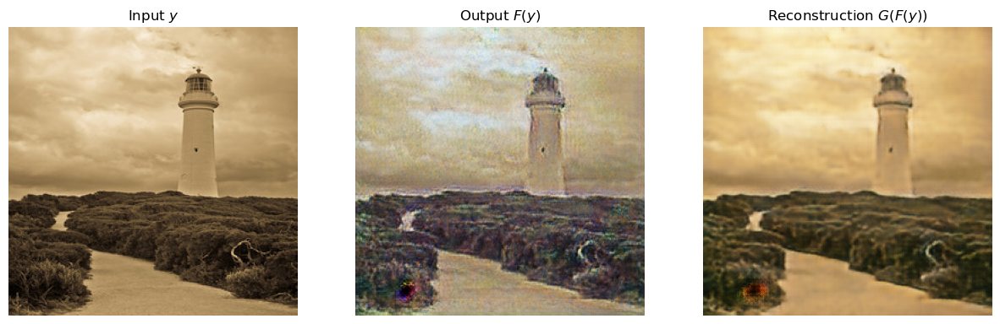

lr=[0.00011600000000000003]
lr=[0.00011200000000000003]
lr=[0.00010800000000000002]
lr=[0.00010400000000000003]
lr=[0.00010000000000000003]


-----------------------------------------------------------------------------------EPOCH #75-----------------------------------------------------------------------------------


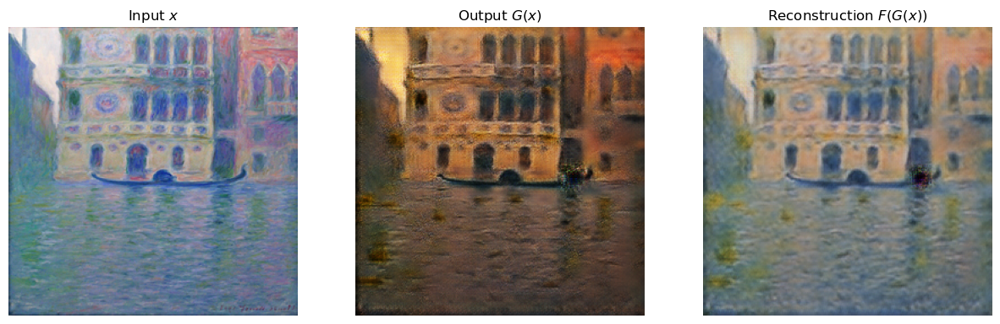

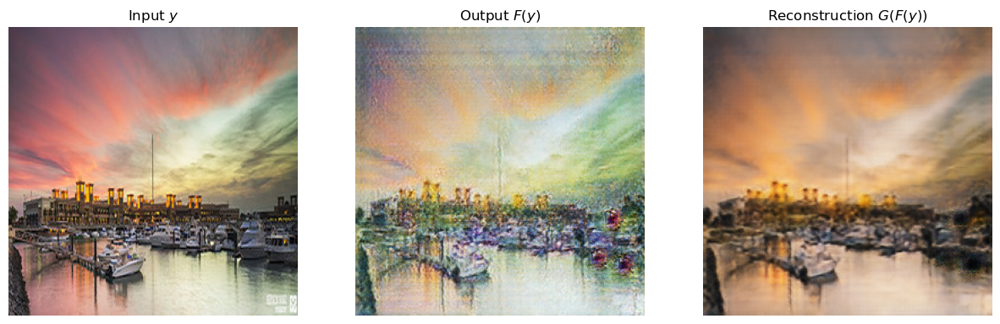

lr=[9.600000000000003e-05]
lr=[9.200000000000003e-05]
lr=[8.800000000000002e-05]
lr=[8.400000000000002e-05]
lr=[8.000000000000002e-05]


-----------------------------------------------------------------------------------EPOCH #80-----------------------------------------------------------------------------------


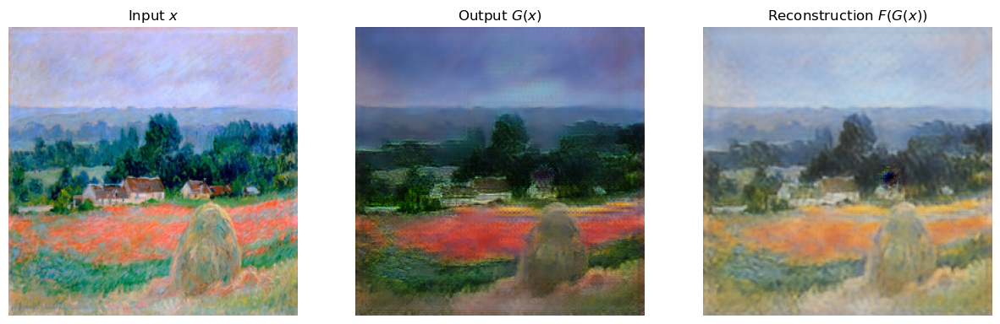

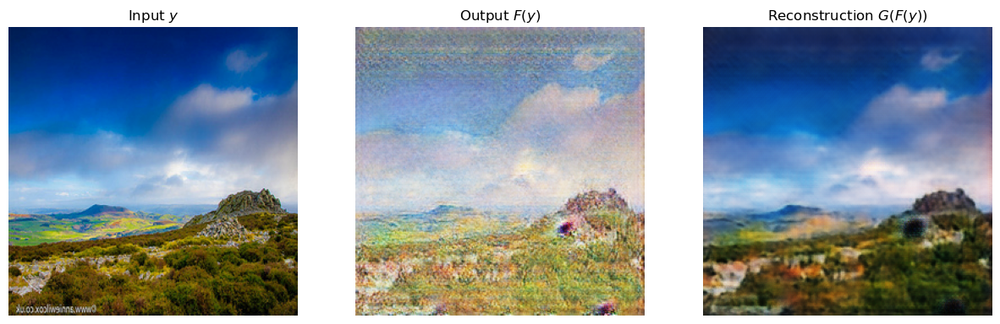

lr=[7.600000000000002e-05]
lr=[7.200000000000002e-05]
lr=[6.800000000000001e-05]
lr=[6.400000000000001e-05]
lr=[6.000000000000001e-05]


-----------------------------------------------------------------------------------EPOCH #85-----------------------------------------------------------------------------------


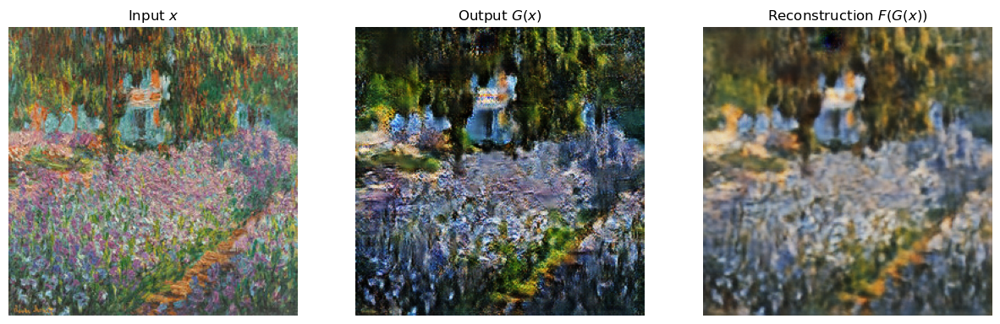

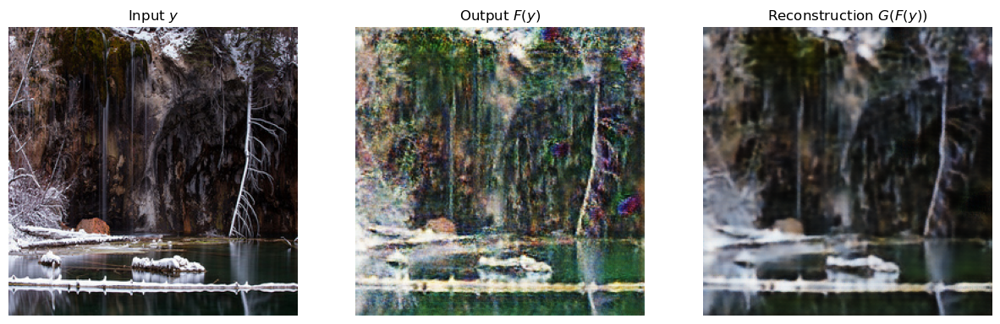

lr=[5.6000000000000006e-05]
lr=[5.200000000000001e-05]
lr=[4.8000000000000015e-05]
lr=[4.400000000000001e-05]
lr=[4.000000000000001e-05]


-----------------------------------------------------------------------------------EPOCH #90-----------------------------------------------------------------------------------


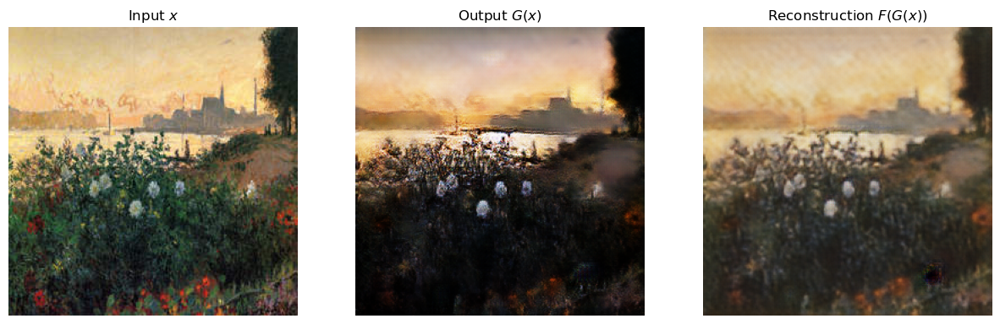

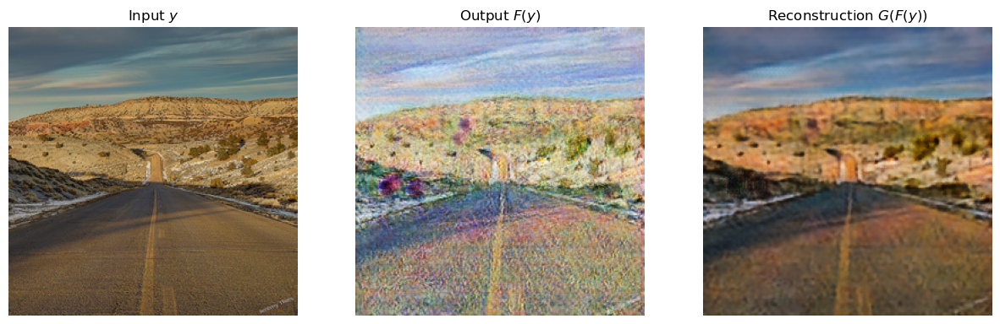

lr=[3.600000000000001e-05]
lr=[3.2000000000000005e-05]
lr=[2.8000000000000003e-05]
lr=[2.4000000000000004e-05]
lr=[2.0000000000000005e-05]


-----------------------------------------------------------------------------------EPOCH #95-----------------------------------------------------------------------------------


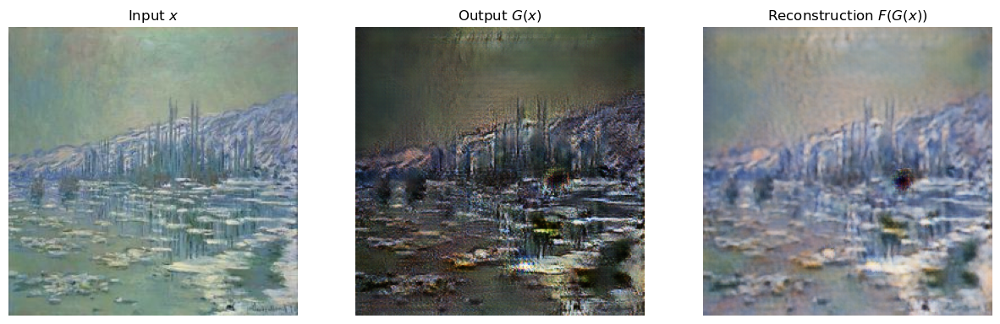

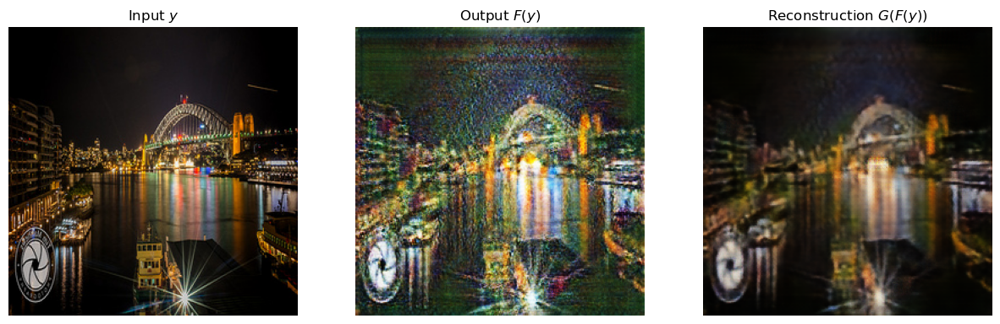

lr=[1.6000000000000006e-05]
lr=[1.2000000000000004e-05]
lr=[8.000000000000003e-06]
lr=[4.0000000000000015e-06]


-----------------------------------------------------------------------------------EPOCH #99-----------------------------------------------------------------------------------


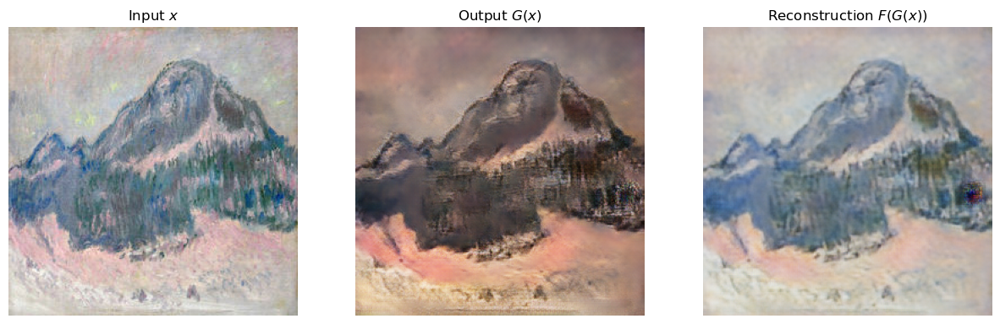

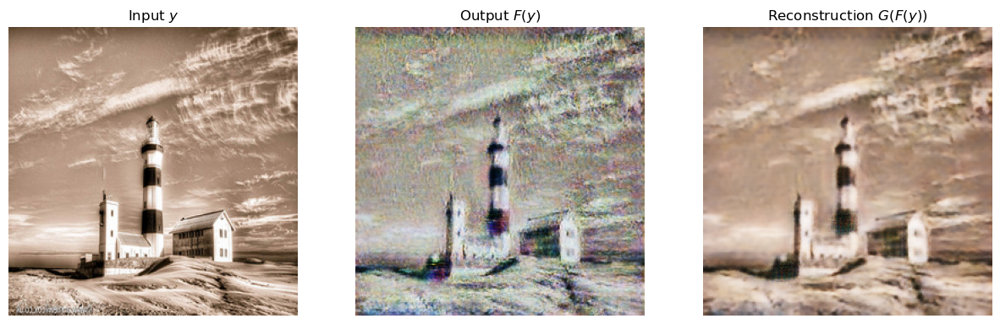

In [30]:
try:
    # ampinitializations
    optimizers = {
        "opt_generators": opt.AdamW(params=list(G_model_A_B.parameters()) + list(F_model_B_A.parameters()), lr=train_state.lr),
        "opt_D_A": opt.AdamW(params=D_A.parameters(), lr=train_state.lr),
        "opt_D_B": opt.AdamW(params=D_B.parameters(), lr=train_state.lr),
    }

    epoch_bar = tqdm(desc="training", total=train_state.num_epochs, position=0)
    train_bar = tqdm(desc="split=train", total=len(train_dataloader) // args.batch_size * 2, position=1, leave=True)

    for epoch_idx in range(train_state.num_epochs):
        torch.cuda.empty_cache()
        if epoch_idx == train_state.lr_total_iters:
            schedulers = {
                "sched_generators": opt.lr_scheduler.LinearLR(optimizers["opt_generators"], start_factor=train_state.lr_start_factor, 
                                                      end_factor=train_state.lr_end_factor, total_iters=train_state.lr_total_iters),
                "sched_D_A": opt.lr_scheduler.LinearLR(optimizers["opt_D_A"], start_factor=train_state.lr_start_factor, 
                                                      end_factor=train_state.lr_end_factor, total_iters=train_state.lr_total_iters),
                "sched_D_B": opt.lr_scheduler.LinearLR(optimizers["opt_D_B"], start_factor=train_state.lr_start_factor, 
                                                      end_factor=train_state.lr_end_factor, total_iters=train_state.lr_total_iters)
            }
        for real_A, real_B in train_dataloader:
            # to cuda
            real_A = apply_transforms(real_A, transforms_).to(args.device)
            real_B = apply_transforms(real_B, transforms_).to(args.device)
            
            # --------------------
            # Discriminators train
            # --------------------
            
            # D_A
            #zero_grad
            optimizers["opt_D_A"].zero_grad()
            # predictions and loss
            generated_A = F_model_B_A(real_B)
            real_patches = D_A(real_A)
            fake_patches = D_A(generated_A.detach())
            loss_real = criterion_GAN(real_patches, torch.ones(real_patches.shape, requires_grad=False).to(args.device))
            loss_fake = criterion_GAN(fake_patches, torch.zeros(fake_patches.shape, requires_grad=False).to(args.device))
            loss = loss_real + loss_fake
            #optimize
            loss.backward()
            optimizers["opt_D_A"].step()
            #store
            train_state.train_loss_disc_A.append(loss.item())
            
            # D_B
            # zero_grad
            optimizers["opt_D_B"].zero_grad()
            # predictions and loss
            generated_B = G_model_A_B(real_A)
            real_patches = D_B(real_B)
            fake_patches = D_B(generated_B.detach())
            loss_real = criterion_GAN(real_patches, torch.ones(real_patches.shape, requires_grad=True).to(args.device))
            loss_fake = criterion_GAN(fake_patches, torch.zeros(fake_patches.shape, requires_grad=True).to(args.device))
            loss = loss_real + loss_fake
            # optimize
            loss.backward()
            optimizers["opt_D_B"].step()
            # store
            train_state.train_loss_disc_B.append(loss.item())
            
            # --------------------
            #   Generators train
            # --------------------
            
            # zero_grad
            optimizers["opt_generators"].zero_grad()
            # predictions and loss
            fake_B = G_model_A_B(real_A)
            patch_B = D_B(fake_B)
            fake_A = F_model_B_A(real_B)
            patch_A = D_A(fake_A)
            # GAN loss
            loss_GAN_A_B = criterion_GAN(patch_B, torch.ones(patch_B.shape, requires_grad=True).to(args.device))
            loss_GAN_B_A = criterion_GAN(patch_A, torch.ones(patch_A.shape, requires_grad=True).to(args.device))
            loss_GAN = loss_GAN_A_B + loss_GAN_B_A
            # cycle loss
            cyc_loss_A = criterion_cycle(F_model_B_A(G_model_A_B(real_A)), real_A)
            cyc_loss_B = criterion_cycle(G_model_A_B(F_model_B_A(real_B)), real_B)
            cyc_loss = cyc_loss_A + cyc_loss_B
            #identity loss
            id_loss_A = criterion_identity(G_model_A_B(real_B), real_B)
            id_loss_B = criterion_identity(F_model_B_A(real_A), real_A)
            id_loss = id_loss_A + id_loss_B
            
            gen_loss = loss_GAN + train_state.lmbd*cyc_loss + 0.5*train_state.lmbd*id_loss
            
            #optimize
            gen_loss.backward()
            optimizers["opt_generators"].step()
            #store
            train_state.train_loss_gen.append(gen_loss.item())
            train_state.train_loss_cyc.append(cyc_loss.item())
            train_state.train_loss_gan.append(loss_GAN.item())
            train_state.train_loss_id.append(id_loss.item())
            
            train_bar.set_postfix(D_A_loss=train_state.train_loss_disc_A[-1], D_B_loss=train_state.train_loss_disc_B[-1],
                                  loss_GAN=loss_GAN.item(), cyc_loss=cyc_loss.item(), 
                                  id_loss=id_loss.item(), gen_loss=gen_loss.item(),
                                  epoch = epoch_idx)
            train_bar.update()
            
        # --------------------------
        #   store, update, display
        # --------------------------
        # store
        if epoch_idx == 0 or epoch_idx % 5 == 0 or epoch_idx == train_state.num_epochs-1:
            torch.save(G_model_A_B.state_dict(), fr"/kaggle/working/G_AB_{epoch_idx}.pth")
            torch.save(F_model_B_A.state_dict(), fr"/kaggle/working/G_BA_{epoch_idx}.pth")
            torch.save(D_A.state_dict(), fr"/kaggle/working/D_A_{epoch_idx}.pth")
            torch.save(D_B.state_dict(), fr"/kaggle/working/D_B_{epoch_idx}.pth")
        
        # update
        if epoch_idx >= train_state.lr_total_iters:
            print(f"lr={schedulers['sched_generators'].get_last_lr()}")
            for _, sched in schedulers.items():
                sched.step()
        
        
        epoch_bar.update() 
        train_bar.n = 0
            
        #display
        if epoch_idx == 0 or epoch_idx % 5 == 0 or epoch_idx == train_state.num_epochs-1:
            print("\n")
            print(f"EPOCH #{epoch_idx}".center(175, "-"))
            display_in_out_rec(G_model_A_B, F_model_B_A, real_A[0], "A2B")
            display_in_out_rec(G_model_A_B, F_model_B_A, real_B[0], "B2A")
        
except KeyboardInterrupt:
    print("Finished")